<a href="https://colab.research.google.com/github/githubpradeep/notebooks/blob/main/T2I_Adapter_SDXL_with_Google_Colab.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install -U git+https://github.com/huggingface/diffusers.git
!pip install -U controlnet_aux==0.0.7
!pip install transformers accelerate

Original blog post
https://note.com/npaka/n/n4e5a290ba344

In [ ]:
import torch
from diffusers import T2IAdapter

adapter = T2IAdapter.from_pretrained(
    "TencentARC/t2i-adapter-lineart-sdxl-1.0",  # Lineart
    torch_dtype=torch.float16,
    varient="fp16"
).to("cuda")

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

In [ ]:
from diffusers import (
    AutoencoderKL,
    EulerAncestralDiscreteScheduler,
    StableDiffusionXLAdapterPipeline,
)

# SDXLAdapterパイプラインの準備
euler_a = EulerAncestralDiscreteScheduler.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    subfolder="scheduler"
)
vae = AutoencoderKL.from_pretrained(
    "madebyollin/sdxl-vae-fp16-fix",
    torch_dtype=torch.float16
)
pipe = StableDiffusionXLAdapterPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    vae=vae,
    adapter=adapter,
    scheduler=euler_a,
    torch_dtype=torch.float16,
    variant="fp16",
).to("cuda")

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [ ]:
from controlnet_aux.lineart import LineartDetector

# LineartDetectorの準備
line_detector = LineartDetector.from_pretrained(
    "lllyasviel/Annotators"
).to("cuda")

/usr/local/lib/python3.10/dist-packages/controlnet_aux/mediapipe_face/mediapipe_face_common.py:7: UserWarning: The module 'mediapipe' is not installed. The package will have limited functionality. Please install it using the command: pip install 'mediapipe'
  warnings.warn(


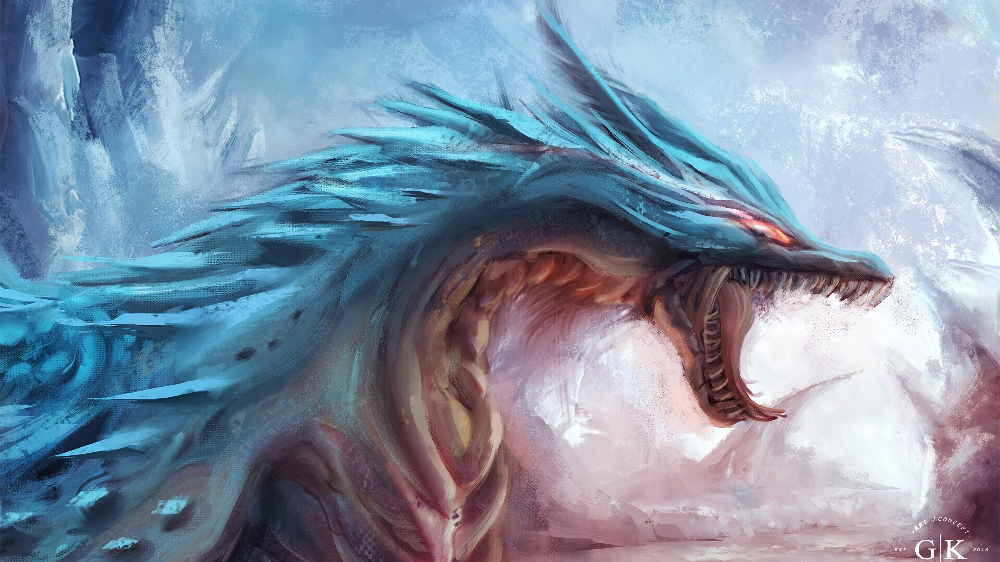

In [ ]:
from diffusers.utils import load_image

# 入力画像の準備
url = "https://huggingface.co/Adapter/t2iadapter/resolve/main/figs_SDXLV1.0/org_lin.jpg"
image = load_image(url)

# 確認
image

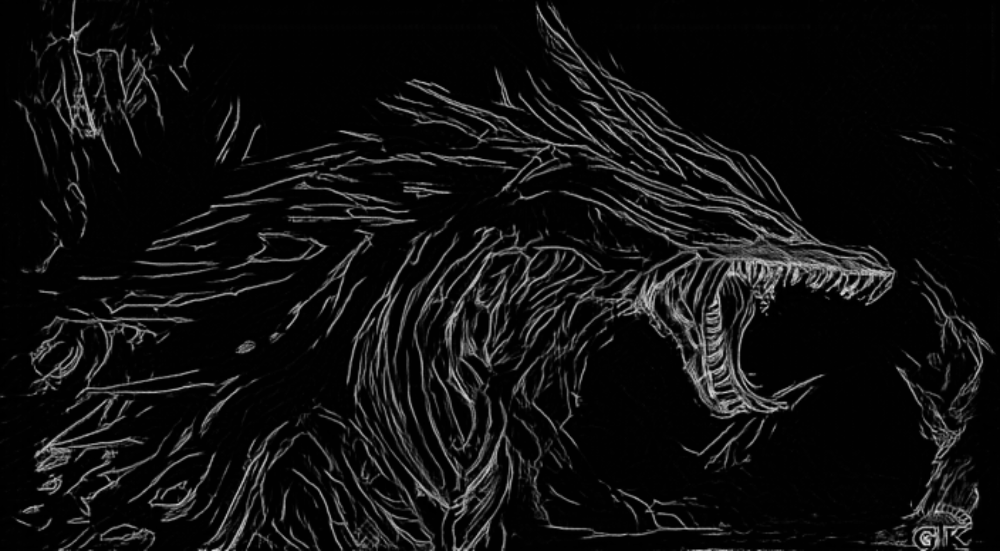

In [ ]:
# 線画の検出
image = line_detector(image, detect_resolution=384, image_resolution=1024)

# 確認
image

  0%|          | 0/30 [00:00<?, ?it/s]

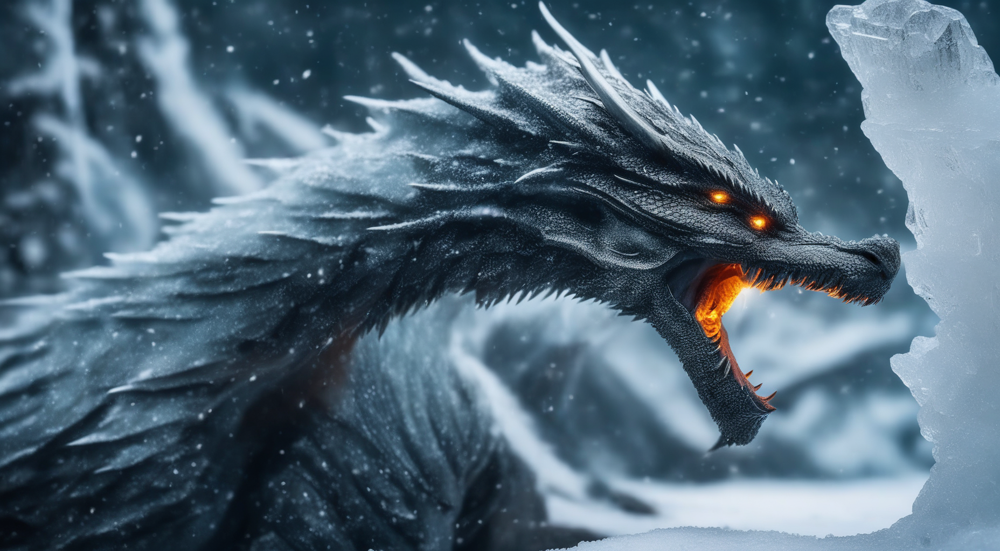

In [ ]:
# プロンプトの準備
prompt = "Ice dragon roar, 4k photo"
negative_prompt = "anime, cartoon, graphic, text, painting, crayon, graphite, abstract, glitch, deformed, mutated, ugly, disfigured"

# 画像生成の実行
gen_images = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    image=image,
    num_inference_steps=30,
    adapter_conditioning_scale=0.8,
    guidance_scale=7.5,
).images[0]

# 確認
gen_images.save("out_lin.png")
gen_images

In [ ]:
image = load_image('https://akm-img-a-in.tosshub.com/indiatoday/images/story/202307/cillian_0-sixteen_nine.jpg?VersionId=lM8G9FFsGcy0isAqoJaZ3KXCzduNX4Or&size=690:388')

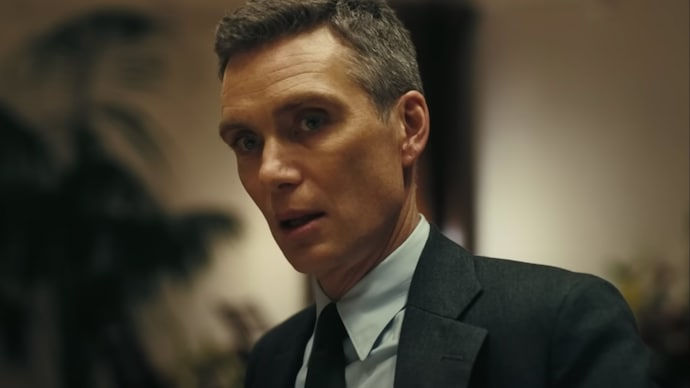

In [ ]:
image

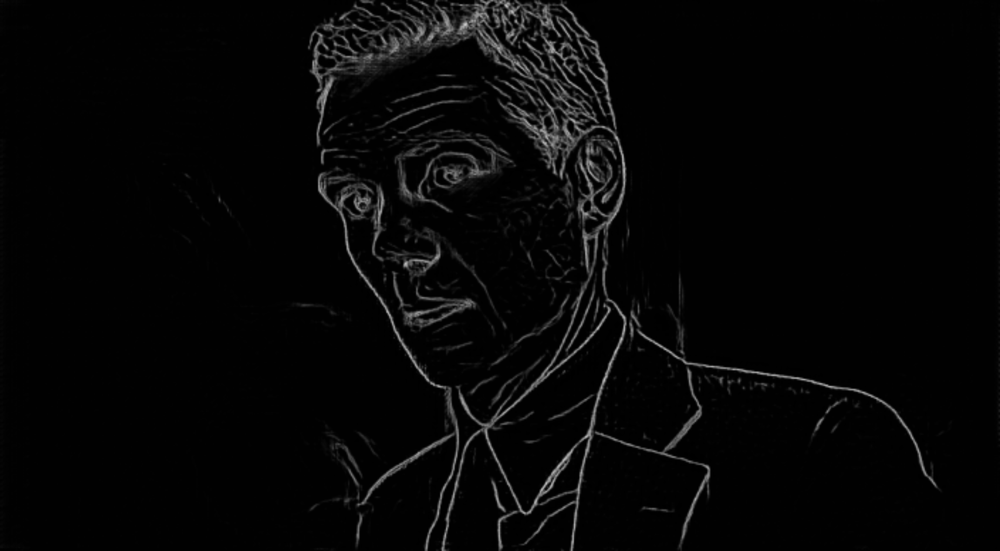

In [ ]:
# 線画の検出
image = line_detector(image, detect_resolution=384, image_resolution=1024)

# 確認
image

  0%|          | 0/30 [00:00<?, ?it/s]

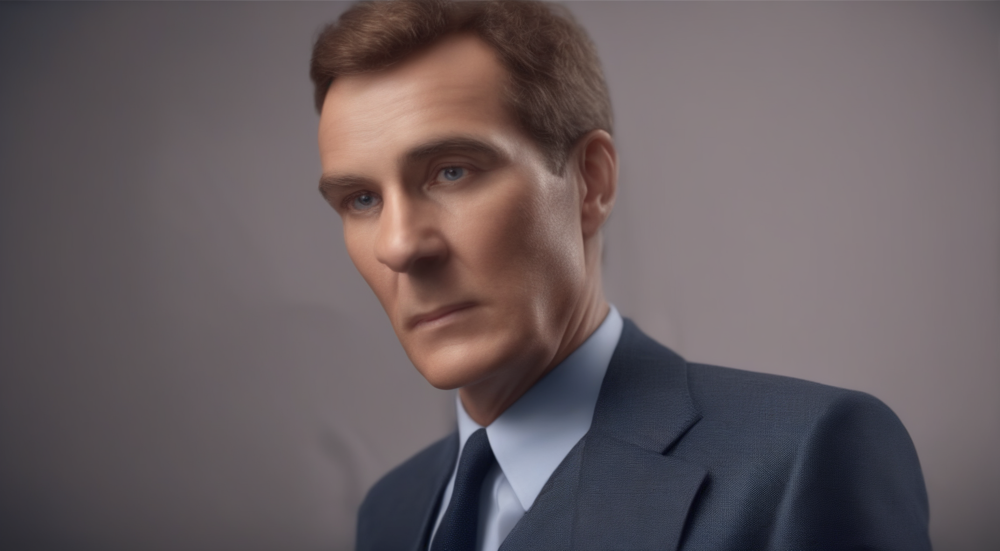

In [ ]:
# プロンプトの準備
prompt = "Openheimer, realistic, 4k photo"
negative_prompt = "anime, cartoon, graphic, text, painting, crayon, graphite, abstract, glitch, deformed, mutated, ugly, disfigured"

# 画像生成の実行
gen_images = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    image=image,
    num_inference_steps=30,
    adapter_conditioning_scale=0.8,
    guidance_scale=7.5,
).images[0]

# 確認
gen_images.save("out_lin.png")
gen_images

In [1]:
from diffusers.utils import load_image

image=load_image('https://media.gettyimages.com/id/1291682560/photo/young-couple-taking-break-from-sightseeing-for-selfie.jpg?s=612x612&w=gi&k=20&c=xDkjLFA6dlqysW4IXaSVrCWD3LSBPfl70k7rOrMd_sE=')

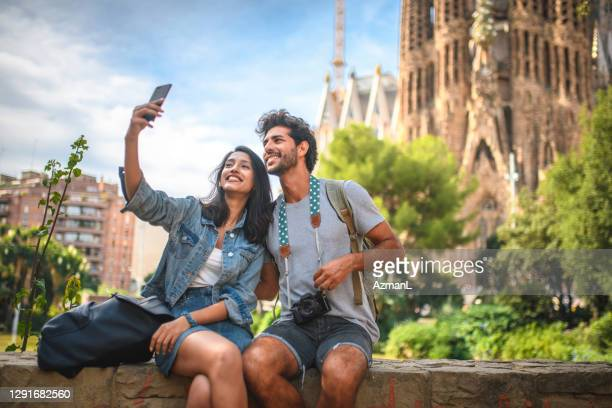

In [2]:
image

In [3]:
import torch
from diffusers import T2IAdapter

adapter = T2IAdapter.from_pretrained(
    "TencentARC/t2i-adapter-openpose-sdxl-1.0",  #
    torch_dtype=torch.float16,
    varient="fp16"
).to("cuda")

In [4]:
from diffusers import (
    AutoencoderKL,
    EulerAncestralDiscreteScheduler,
    StableDiffusionXLAdapterPipeline,
)

# SDXLAdapterパイプラインの準備
euler_a = EulerAncestralDiscreteScheduler.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    subfolder="scheduler"
)
vae = AutoencoderKL.from_pretrained(
    "madebyollin/sdxl-vae-fp16-fix",
    torch_dtype=torch.float16
)
pipe = StableDiffusionXLAdapterPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    vae=vae,
    adapter=adapter,
    scheduler=euler_a,
    torch_dtype=torch.float16,
    variant="fp16",
).to("cuda")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [5]:
from controlnet_aux.open_pose import OpenposeDetector


openpose_detector = OpenposeDetector.from_pretrained(
    "lllyasviel/Annotators"
).to("cuda")

/usr/local/lib/python3.10/dist-packages/controlnet_aux/mediapipe_face/mediapipe_face_common.py:7: UserWarning: The module 'mediapipe' is not installed. The package will have limited functionality. Please install it using the command: pip install 'mediapipe'
  warnings.warn(


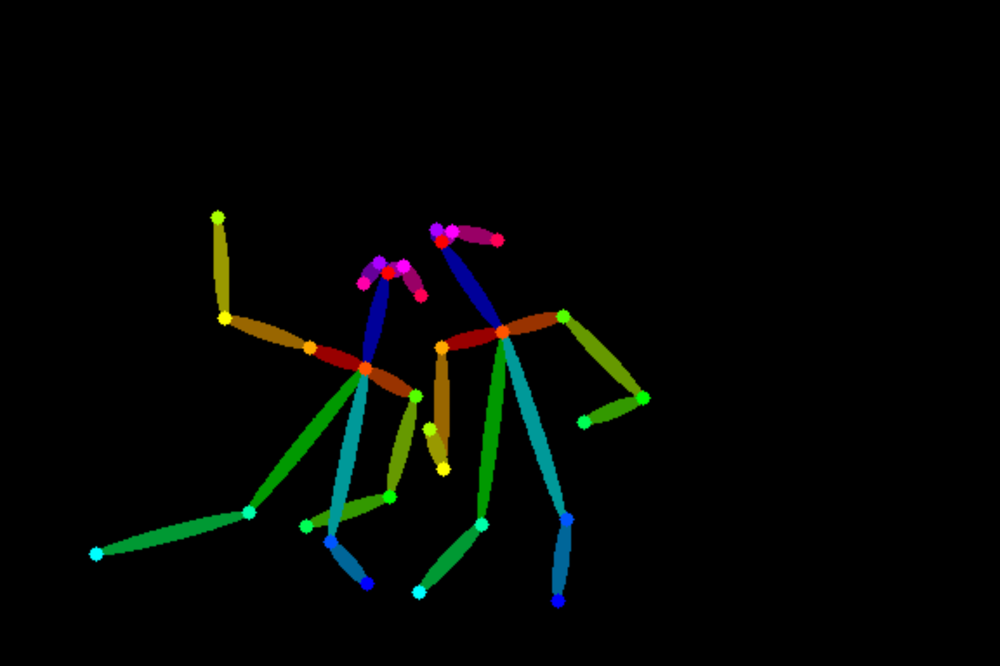

In [6]:
# 線画の検出
image = openpose_detector(image, detect_resolution=384, image_resolution=1024)

# 確認
image

  0%|          | 0/30 [00:00<?, ?it/s]

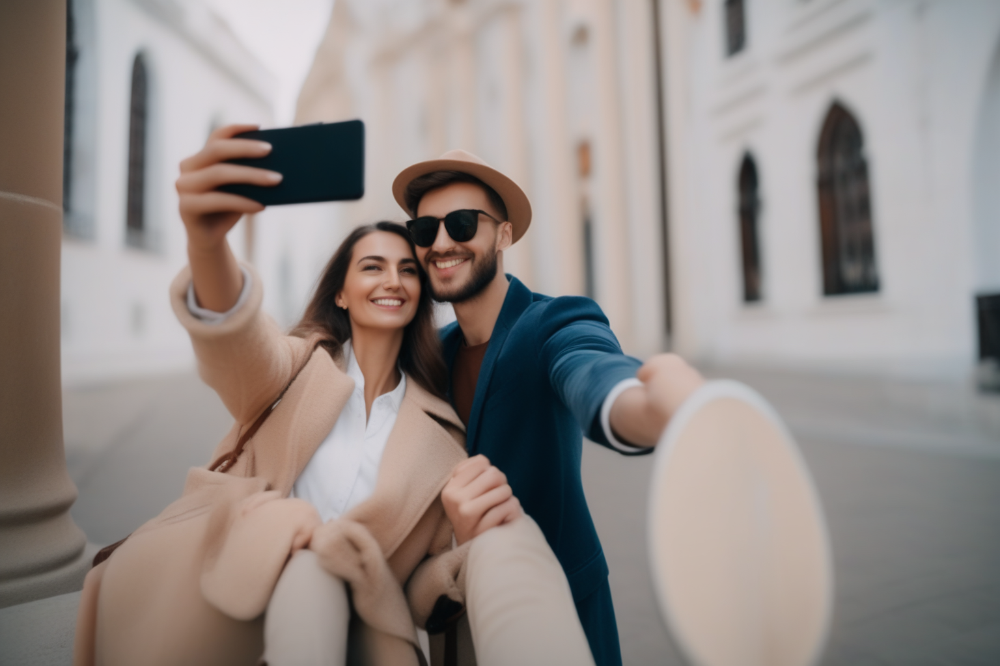

In [7]:
#
prompt = "Happy young couple taking selfie, 4k photo"
negative_prompt = "anime, cartoon, graphic, text, painting, crayon, graphite, abstract, glitch, deformed, mutated, ugly, disfigured"

#
gen_images = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    image=image,
    num_inference_steps=30,
    adapter_conditioning_scale=0.8,
    guidance_scale=7.5,
).images[0]

# 確認
gen_images.save("out_lin.png")
gen_images